# 案例数据背景介绍

1.数据来源：

     Dongjin Cho，韩国蔚山国立科技学院城市与环境工程学院

     Cheolhee Yoo，韩国蔚山国立科技学院城市与环境工程学院


2.摘要：

    本案例所使用的数据集包含了韩国首尔2013至2017年夏天的14个天气预报（NWP）的气象预报数据、2个现场观测数据和5个地理辅助变量。



3.数据集信息：

    这些数据是为了修正韩国气象局在首尔运行的LDAPS(Local Data Assimilation and Prediction System)模式下次日最高和最低气温预报的偏差。该数据包括2013年至2017年的夏季数据。输入数据主要由LDAPS模型的次日预报数据、当前的现场最高和最低气温以及地理辅助变量组成。此数据有两个输出数据（即第二天的最高和最低气温）；2015年至2017年期间进行了后期验证。
    关于LDAPS模式: http://qikan.camscma.cn/jamsweb/cn/article/doi/10.11898/1001-7313.20200103?viewType=HTML


4.数据属性介绍：

      1. station - 气象站编号: 1 - 25 
      
      2. Date - 记录日期: yyyy-mm-dd ('2013-06-30' to '2017-08-30') 
      
      3. Present_Tmax - 记录日期的0-21时最高气温(Â°C): 20 - 37.6 
      
      4. Present_Tmin - 记录日期的0-21时最低气温(Â°C): 11.3 - 29.9 
      
      5. LDAPS_RHmin - LDAPSM模式预测的次日最小相对湿度 (%): 19.8 - 98.5 
      
      6. LDAPS_RHmax - LDAPS模式预测的次日最大相对湿度 (%): 58.9 - 100 
      
      7. LDAPS_Tmax_lapse - LDAPS模式预测的次日最高气温递减率 (Â°C): 17.6 - 38.5 
      
      8. LDAPS_Tmin_lapse - LDAPS模式预测的次日最高气温递减率 (Â°C): 14.3 - 29.6 
      
      9. LDAPS_WS - LDAPS 模式预测的次日平均风速 (m/s): 2.9 to 21.9 
      
      10. LDAPS_LH - LDAPS模式预测的次日平均潜热通量 (W/m2): -13.6 - 213.4 
      
      11. LDAPS_CC1 - LDAPS模式预测的次日第一个6小时平均云量 (0-5 h) (%): 0 - 0.97 
      
      12. LDAPS_CC2 - LDAPS模式预测的次日第二个6小时平均云量 (0-5 h) (6-11 h) (%): 0 to 0.97 
      
      13. LDAPS_CC3 - LDAPS模式预测的次日第三个6小时平均云量 (0-5 h) (12-17 h) (%): 0 to 0.98 
      
      14. LDAPS_CC4 - LDAPS模式预测的次日第四个6小时平均云量 (0-5 h) (18-23 h) (%): 0 to 0.97 
      
      15. LDAPS_PPT1 - LDAPS模式预测的次日第一个6小时平均降水量 (0-5 h) (%): 0 to 23.7 
      
      16. LDAPS_PPT2 - LDAPS模式预测的次日第二个6小时平均降水量  (6-11 h) (%): 0 to 21.6 
      
      17. LDAPS_PPT3 - LDAPS模式预测的次日第三个6小时平均降水量 (12-17 h) (%): 0 to 15.8 
      
      18. LDAPS_PPT4 - LDAPS模式预测的次日第四个6小时平均降水量  (18-23 h) (%): 0 to 16.7 
      
      19. lat - 维度 (Â°): 37.456 - 37.645 
      
      20. lon - 经度 (Â°): 126.826 - 127.135 
      
      21. DEM - 高程 (m): 12.4 - 212.3 
      
      22. Slope - 坡度 (Â°): 0.1 - 5.2 
      
      23. Solar radiation - 太阳辐射量 (wh/m2): 4329.5 to 5992.9 
      
      24. Next_Tmax - 次日最高气温 (Â°C): 17.4 to 38.9 
      
      25. Next_Tmin - 次日最低气温 (Â°C): 11.3 to 29.8
      



**5. sklearn中常见的几个线性回归类库：**

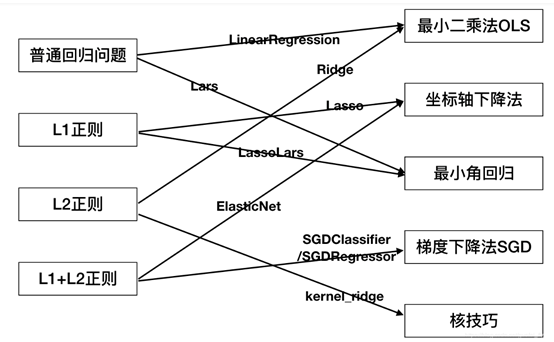

# 读取数据

In [110]:
import numpy as np
import pandas as pd
import pandas_profiling as pp 
import matplotlib.pyplot as plt
import seaborn as sns

#全部行都能输出
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"


In [2]:
Data = pd.read_csv(r"Dataset.csv")
Data

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,6/30/2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,6/30/2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,6/30/2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,6/30/2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,6/30/2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,8/30/2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,8/30/2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,8/30/2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


# 数据探索

## 基本统计信息

In [3]:
Data.describe().T 

,count,mean,std,min,25%,50%,75%,max
station,7750.0,13.000000,7.211568,1.000000,7.000000,13.000000,19.000000,25.000000
Present_Tmax,7682.0,29.768211,2.969999,20.000000,27.800000,29.900000,32.000000,37.600000
Present_Tmin,7682.0,23.225059,2.413961,11.300000,21.700000,23.400000,24.900000,29.900000
LDAPS_RHmin,7677.0,56.759372,14.668111,19.794666,45.963543,55.039024,67.190056,98.524734
LDAPS_RHmax,7677.0,88.374804,7.192004,58.936283,84.222862,89.793480,93.743629,100.000153
LDAPS_Tmax_lapse,7677.0,29.613447,2.947191,17.624954,27.673499,29.703426,31.710450,38.542255
LDAPS_Tmin_lapse,7677.0,23.512589,2.345347,14.272646,22.089739,23.760199,25.152909,29.619342
LDAPS_WS,7677.0,7.097875,2.183836,2.882580,5.678705,6.547470,8.032276,21.857621
LDAPS_LH,7677.0,62.505019,33.730589,-13.603212,37.266753,56.865482,84.223616,213.414006
LDAPS_CC1,7677.0,0.368774,0.262458,0.000000,0.146654,0.315697,0.575489,0.967277


In [4]:
Data.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


## 查看空值（5分）

In [5]:
Data.isna().sum() 

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [5]:
# 取出有空值的行
data_row_null = Data[Data.isna().T.any()]
data_row_null.shape
# 取出所有有空值的记录  （5分）

(164, 25)

## 查看每列数据的分布状态

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='station', ylabel='Density'>

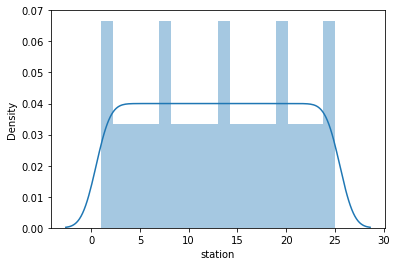

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Present_Tmax', ylabel='Density'>

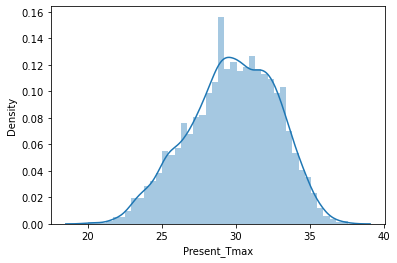

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Present_Tmin', ylabel='Density'>

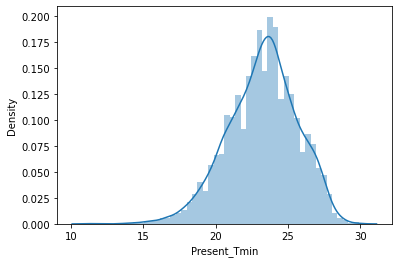

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_RHmin', ylabel='Density'>

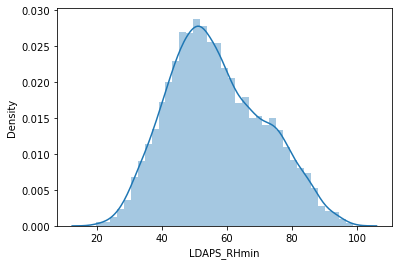

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_RHmax', ylabel='Density'>

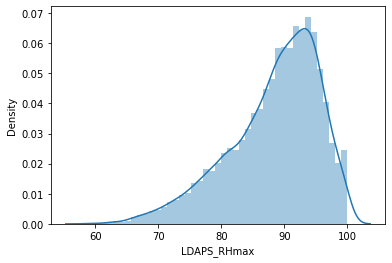

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_Tmax_lapse', ylabel='Density'>

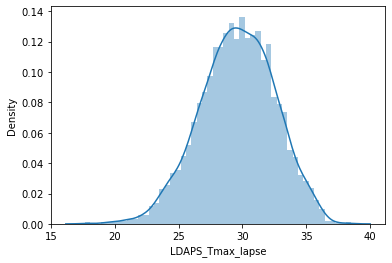

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_Tmin_lapse', ylabel='Density'>

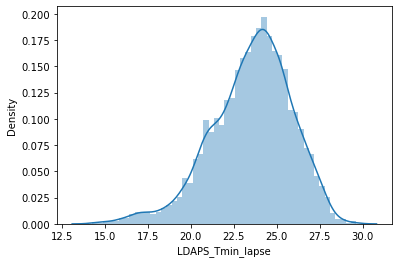

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_WS', ylabel='Density'>

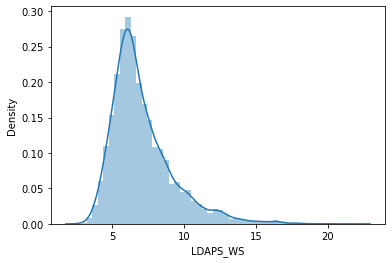

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_LH', ylabel='Density'>

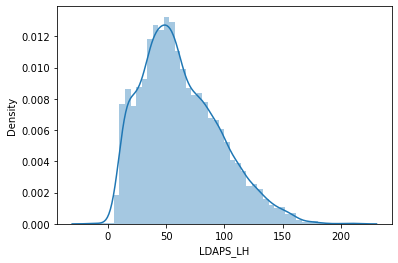

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_CC1', ylabel='Density'>

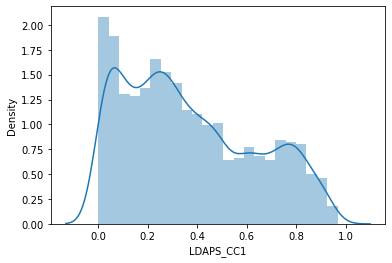

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_CC2', ylabel='Density'>

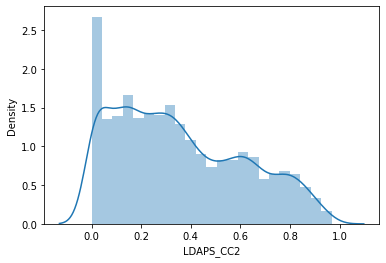

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_CC3', ylabel='Density'>

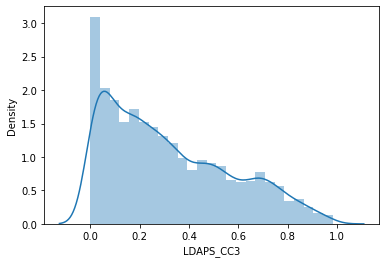

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_CC4', ylabel='Density'>

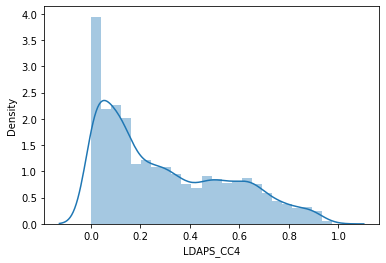

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_PPT1', ylabel='Density'>

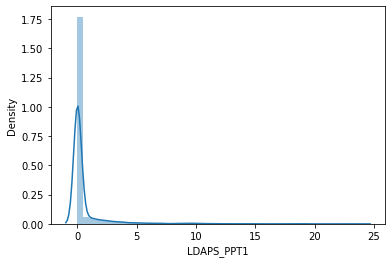

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_PPT2', ylabel='Density'>

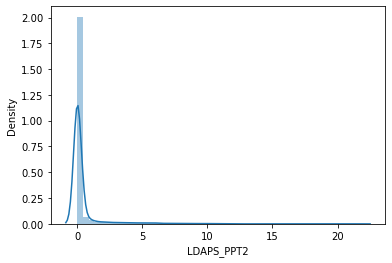

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_PPT3', ylabel='Density'>

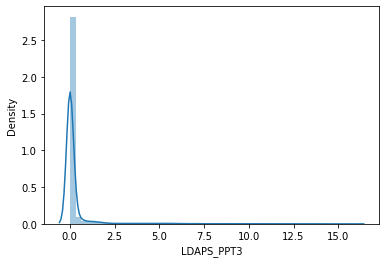

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='LDAPS_PPT4', ylabel='Density'>

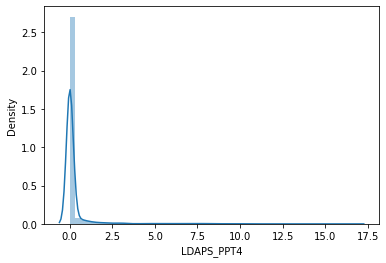

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='lat', ylabel='Density'>

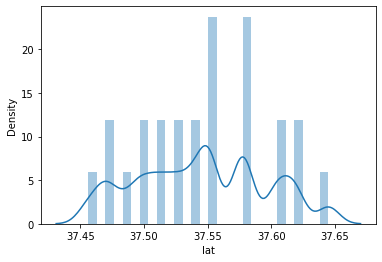

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='lon', ylabel='Density'>

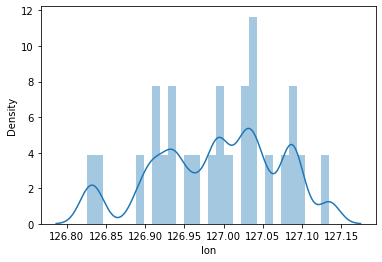

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='DEM', ylabel='Density'>

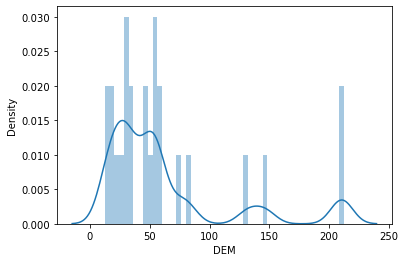

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Slope', ylabel='Density'>

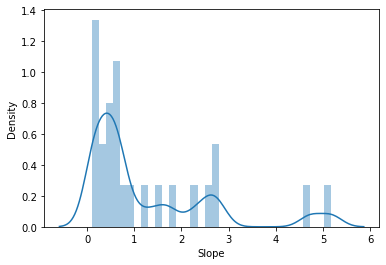

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Solar radiation', ylabel='Density'>

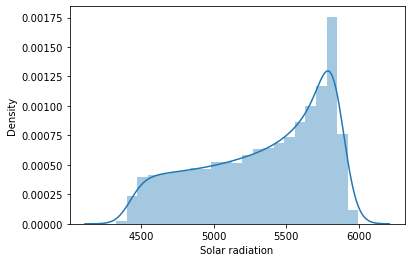

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Next_Tmax', ylabel='Density'>

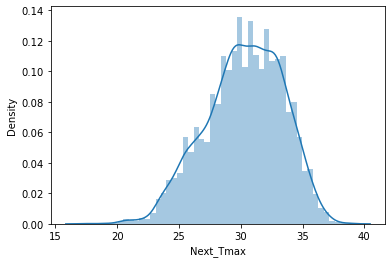

/Users/zhouhan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Next_Tmin', ylabel='Density'>

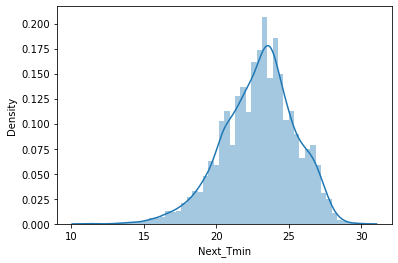

In [36]:
# 绘制每列数据的直方图（分布频次）
plot = Data.drop('Date',axis=1) # 删除'Date'列

for I in plot.columns:
    sns.distplot(plot[I]) 
    plt.show() 

## 生成数据概况报告

In [37]:
# 生成整体数据概要
data_report=pp.ProfileReport(Data) 
data_report

# 也可以把生成的报告导出保存
data_report.to_file('report.html') 


# 数据预处理

## 提取数据

In [6]:
# 由于本数据集的特殊性（有两个样本标签：次日最高气温和最低气温）
#，本案例中我们只进行次日最高温预测--因此这里只选出与最高温预测相关的变量，作为建模要用的数据

Max = Data[['Present_Tmax','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT4',
          'lat','lon','DEM','Slope','Solar radiation','Next_Tmax']] 

In [7]:
Max.head() 

,Present_Tmax,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax
0,28.7,91.116364,28.074101,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1
1,31.9,90.604721,29.850689,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5
2,31.6,83.973587,30.091292,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1
3,32.0,96.483688,29.704629,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7
4,31.4,90.155128,29.113934,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2


In [8]:
Max.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Present_Tmax      7682 non-null   float64
 1   LDAPS_RHmax       7677 non-null   float64
 2   LDAPS_Tmax_lapse  7677 non-null   float64
 3   LDAPS_WS          7677 non-null   float64
 4   LDAPS_LH          7677 non-null   float64
 5   LDAPS_CC1         7677 non-null   float64
 6   LDAPS_CC2         7677 non-null   float64
 7   LDAPS_CC3         7677 non-null   float64
 8   LDAPS_CC4         7677 non-null   float64
 9   LDAPS_PPT1        7677 non-null   float64
 10  LDAPS_PPT4        7677 non-null   float64
 11  lat               7752 non-null   float64
 12  lon               7752 non-null   float64
 13  DEM               7752 non-null   float64
 14  Slope             7752 non-null   float64
 15  Solar radiation   7752 non-null   float64
 16  Next_Tmax         7725 non-null   float64


In [9]:
Max.describe().T

,count,mean,std,min,25%,50%,75%,max
Present_Tmax,7682.0,29.768211,2.969999,20.000000,27.800000,29.900000,32.000000,37.600000
LDAPS_RHmax,7677.0,88.374804,7.192004,58.936283,84.222862,89.793480,93.743629,100.000153
LDAPS_Tmax_lapse,7677.0,29.613447,2.947191,17.624954,27.673499,29.703426,31.710450,38.542255
LDAPS_WS,7677.0,7.097875,2.183836,2.882580,5.678705,6.547470,8.032276,21.857621
LDAPS_LH,7677.0,62.505019,33.730589,-13.603212,37.266753,56.865482,84.223616,213.414006
LDAPS_CC1,7677.0,0.368774,0.262458,0.000000,0.146654,0.315697,0.575489,0.967277
LDAPS_CC2,7677.0,0.356080,0.258061,0.000000,0.140615,0.312421,0.558694,0.968353
LDAPS_CC3,7677.0,0.318404,0.250362,0.000000,0.101388,0.262555,0.496703,0.983789
LDAPS_CC4,7677.0,0.299191,0.254348,0.000000,0.081532,0.227664,0.499489,0.974710
LDAPS_PPT1,7677.0,0.591995,1.945768,0.000000,0.000000,0.000000,0.052525,23.701544


## 填充缺失值（10分）

In [41]:
# 用每列的均值填充其缺失值
fil = Max[Max.isna().T.any()].columns  # 求有空值的列
fil = pd.DataFrame(fil)[0].tolist()    # 转换为list
Max[fil].mean()                        # 求均值
dic = dict(zip(fil,Max[fil].mean()))   # 返回每列均值的字典
Max = Max.fillna(dic)                  # 填充缺失值

Present_Tmax          29.768211
LDAPS_RHmax           88.374804
LDAPS_Tmax_lapse      29.613447
LDAPS_WS               7.097875
LDAPS_LH              62.505019
LDAPS_CC1              0.368774
LDAPS_CC2              0.356080
LDAPS_CC3              0.318404
LDAPS_CC4              0.299191
LDAPS_PPT1             0.591995
LDAPS_PPT4             0.269407
lat                   37.544722
lon                  126.991397
DEM                   61.867972
Slope                  1.257048
Solar radiation     5341.502803
Next_Tmax             30.274887
dtype: float64

In [42]:
Max.isnull().sum() 

Present_Tmax        0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
dtype: int64

## 标准化处理连续型特征

In [111]:
from sklearn.preprocessing import StandardScaler

#标准化处理连续型特征 （10分）
scaler = StandardScaler()
Scaled_Data = scaler.fit(Max)
Scaled_Data = scaler.transform(Max)
Scaled_Data = pd.DataFrame(Scaled_Data,columns=Max.columns)
Scaled_Data.head()

,Present_Tmax,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax
0,-0.361326,0.383078,-0.524889,-0.128382,0.206966,-0.516243,-0.592636,-0.629013,-0.664815,-0.30575,-0.224453,1.189286,-0.005000,2.772243,1.115004,1.517935,-0.376282
1,0.721084,0.311586,0.080895,-0.646994,-0.314841,-0.548557,-0.406199,-0.638055,-0.677462,-0.30575,-0.224453,1.189286,0.511177,-0.315157,-0.542158,1.229950,0.072097
2,0.619608,-0.614982,0.162936,-0.441604,-1.249283,-0.610450,-0.384009,-0.458843,-0.620575,-0.30575,-0.224453,0.653021,0.838510,-0.526218,-0.723133,1.216534,0.264260
3,0.754909,1.133054,0.031092,-0.666247,0.095997,-0.583539,-0.506548,-0.631178,-0.651696,-0.30575,-0.224453,1.991696,0.385280,-0.297588,0.932424,1.201176,0.456422
4,0.551957,0.248765,-0.170325,-0.627154,1.354409,-0.832287,-0.413115,-0.559990,-0.510358,-0.30575,-0.224453,0.118743,1.807917,-0.494322,-0.548433,1.207205,0.296287


## 划分特征列和标签列

In [52]:
X = Scaled_Data.drop(['Next_Tmax'],axis=1) 
X.head() 

,Present_Tmax,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation
0,-0.361326,0.383078,-0.524889,-0.128382,0.206966,-0.516243,-0.592636,-0.629013,-0.664815,-0.30575,-0.224453,1.189286,-0.005000,2.772243,1.115004,1.517935
1,0.721084,0.311586,0.080895,-0.646994,-0.314841,-0.548557,-0.406199,-0.638055,-0.677462,-0.30575,-0.224453,1.189286,0.511177,-0.315157,-0.542158,1.229950
2,0.619608,-0.614982,0.162936,-0.441604,-1.249283,-0.610450,-0.384009,-0.458843,-0.620575,-0.30575,-0.224453,0.653021,0.838510,-0.526218,-0.723133,1.216534
3,0.754909,1.133054,0.031092,-0.666247,0.095997,-0.583539,-0.506548,-0.631178,-0.651696,-0.30575,-0.224453,1.991696,0.385280,-0.297588,0.932424,1.201176
4,0.551957,0.248765,-0.170325,-0.627154,1.354409,-0.832287,-0.413115,-0.559990,-0.510358,-0.30575,-0.224453,0.118743,1.807917,-0.494322,-0.548433,1.207205


In [53]:
Y = Scaled_Data['Next_Tmax']
Y

0      -0.376282
1       0.072097
2       0.264260
3       0.456422
4       0.296287
          ...   
7747   -0.632499
7748   -0.536418
7749   -0.792634
7750   -4.123453
7751    2.762374
Name: Next_Tmax, Length: 7752, dtype: float64

# 创建线性回归模型并评估

## 划分数据集（5分）

In [112]:
from sklearn.model_selection import train_test_split

Xtrain,Xtest,Ytrain,Ytest = train_test_split(X,Y,test_size=0.2,random_state=100)

In [113]:
Ytrain

1241    1.000883
6539    1.096964
5642    1.929669
6403   -0.344255
6410   -0.248174
          ...   
79     -0.504391
3927    0.296287
5955    1.321154
6936    0.744666
5640    0.488450
Name: Next_Tmax, Length: 6201, dtype: float64

## 建模（5分）

In [64]:
from sklearn.linear_model import LinearRegression

reg = LinearRegression().fit(Xtrain, Ytrain)

## 评估（5分）

In [101]:
reg.score(Xtrain,Ytrain),reg.score(Xtest,Ytest)

(0.7561242611114561, 0.7471399054999794)

## 计算MSE与RMSE（10分）

In [192]:
from sklearn.metrics import mean_squared_error

Y_pre = reg.predict(Xtest)
MSE = mean_squared_error(Ytest,Y_pre)
RMSE = MSE ** .5
MSE,RMSE

(0.25257359520157063, 0.5025670056833921)

# 模型诊断

## 绘制线性拟合图（10分）

'''
从上可以看到RMSE(越小越好）的值0.5，我们通过可视化来看一下训练后的预测和真实值之间的差异：
'''

<Figure size 1440x720 with 0 Axes>

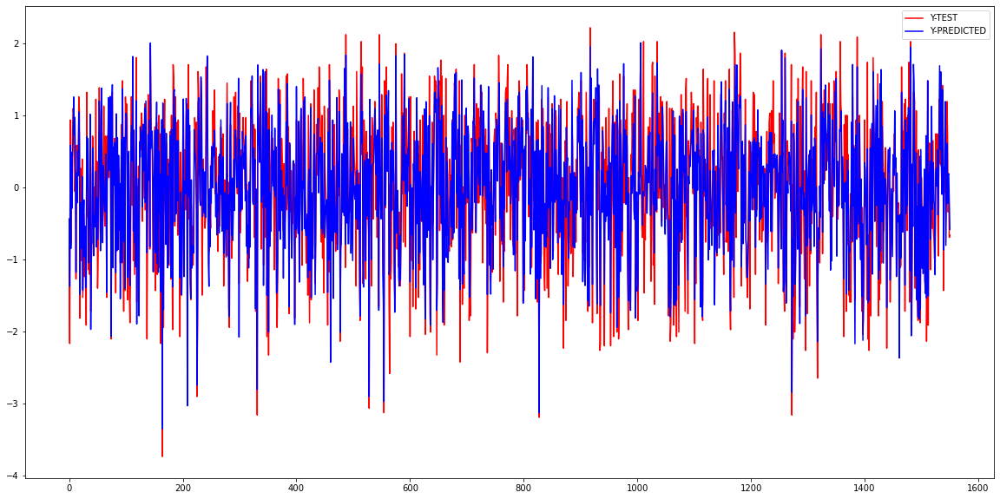

In [74]:
# 画个折线图来看看模型拟合的好坏程度
plt.figure(figsize=(20,10)) 
plt.plot(range(len(Ytest)), Ytest, 'r', label='Y-TEST')
plt.plot(range(len(Ytest)), Y_pre, 'b', label='Y-PREDICTED')
plt.legend() 

'''
可以看到许多地方，红线会明显超出蓝线，说明我们的模型拟合度不够，再换个散点图来更直观地看一下：
'''

Text(0.5, 1.0, 'LinerRegression')

Text(0.5, 0, 'Y-TEST')

Text(0, 0.5, 'Y-PREDICTED')

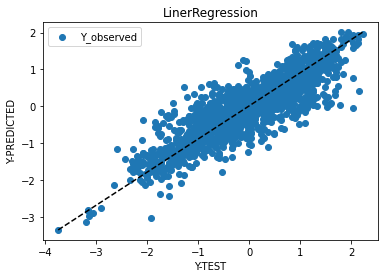

In [116]:
#使用散点图观测（10分）
plt.scatter(Ytest,Y_pre,label='Y_observed')
plt.plot([Ytest.min(),Ytest.max()],[Y_pre.min(),Y_pre.max()],'k--')
plt.title('LinerRegression')
plt.xlabel("Y-TEST")
plt.ylabel("Y-PREDICTED")
plt.legend()
plt.show()

'''
图中我们可以看到，如果完全拟合，散点应该和直线相重合，这里发现，y_test有一些的异常值，
而线性回归模型的一大缺点就是对异常值很敏感，会极大影响模型的准确性，因此，下一步，我们就根据这一点，对模型进行优化
'''

## 绘制残差图（10分）

Text(0.5, 0, 'Y_observed')

Text(0, 0.5, 'Y_predicted')

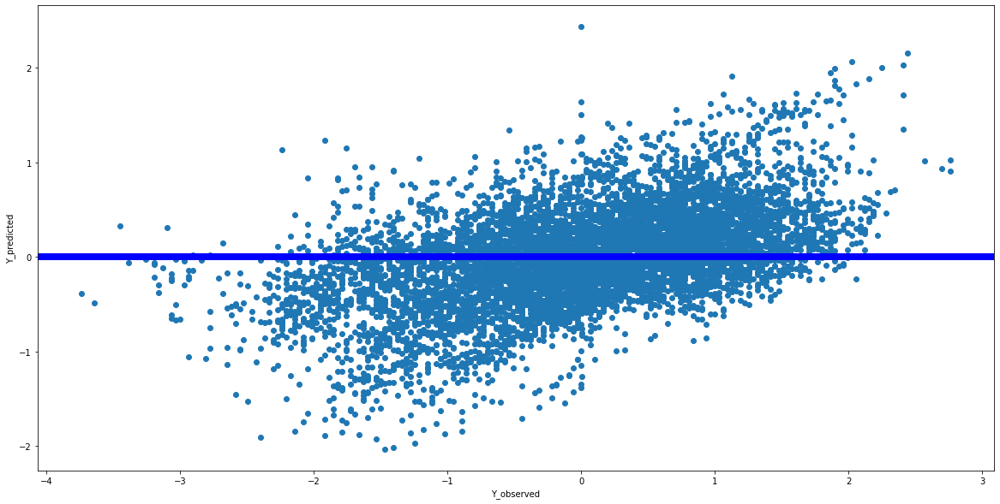

In [242]:
# 绘制残差图查看模型的拟合情况（10分）
from sklearn.model_selection import cross_val_predict,cross_val_score

Y_pred = cross_val_predict(lr,X,Y,cv=10)

fig,ax = plt.subplots(figsize=(20,10))
ax.scatter(Y,Y - Y_pred)
ax.axhline(lw=8,color='blue')
ax.set_xlabel('Y_observed')
ax.set_ylabel('Y_predicted')
plt.show()

## 绘制相关性热图（10分）

**绘制各预测变量间的相关性热图，查看是否存在相关性很高的变量（共线性或近似共线性）**

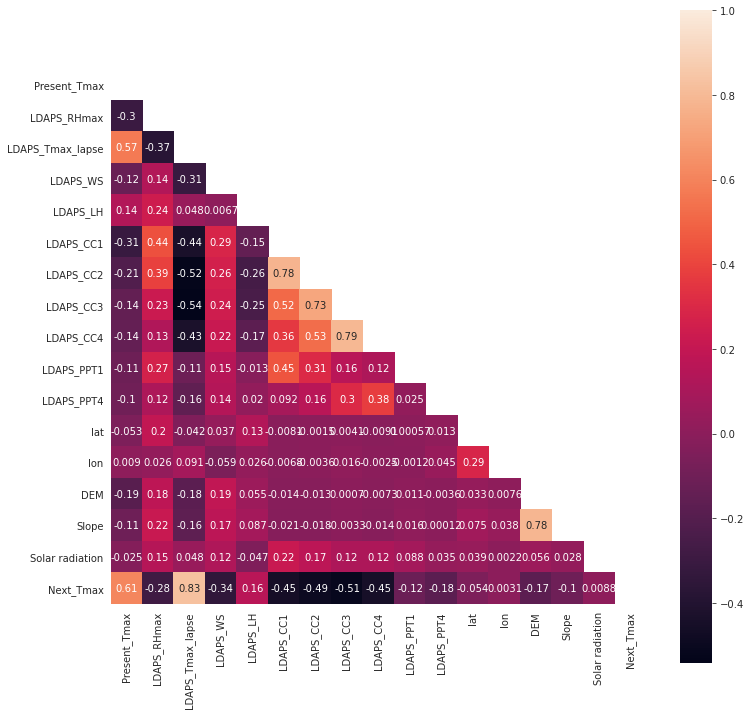

In [131]:
corr = Scaled_Data.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(12,12))
    ax = sns.heatmap(corr,mask=mask,vmax=1,square=True,annot=True)

# 模型调优

## 删除异常值（10分）

<AxesSubplot:>

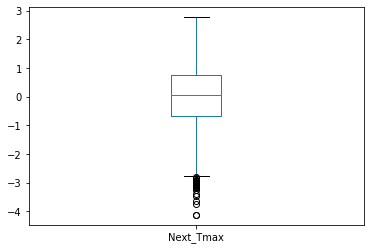

In [129]:
#####================寻找异常值====================######

Scaled_Data['Next_Tmax'].plot.box() 

In [186]:
# 删除掉Next_Tmax中小于下边缘值的记录（10分）
Q1, Q3 = np.percentile(Scaled_Data['Next_Tmax'],(0.25,0.75))
IQR = Q3 - Q1
low_whisker = Q1 - 1.5*IQR
up_whisker = Q3 + 1.5*IQR
low_whisker, up_whisker

(-3.8575878207889565, -1.662770694023558)

In [187]:
# Y中小于箱型图下边缘的值
Scaled_Data[Scaled_Data['Next_Tmax']<low_whisker] 

,Present_Tmax,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax
6175,-2.695272,1.457979,-4.087857,4.911091,-0.210420,1.489658,2.281600,2.656311,2.268567,-0.017489,1.340116,1.189286,-0.005000,2.772243,1.115004,-1.786106,-4.123453
7750,-3.304127,-4.113443,-4.087857,-1.939757,-2.267499,-1.412018,-1.386643,-1.278054,-1.182118,-0.305750,-0.224453,-1.758184,-2.082302,-0.911963,-0.845455,-2.358212,-4.123453


In [188]:
# 要删除的样本的Index
drop_index=Scaled_Data[Scaled_Data['Next_Tmax']<low_whisker].index.values
drop_index

array([6175, 7750])

In [189]:
# 删除Y中小于箱型图下边缘的值
X=X.drop(drop_index)
Y=Y.drop(drop_index)

In [190]:
# 删除后的X,Y -------少了两行
X
Y 

,Present_Tmax,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation
0,-0.361326,0.383078,-0.524889,-0.128382,0.206966,-0.516243,-0.592636,-0.629013,-0.664815,-0.305750,-0.224453,1.189286,-0.005000,2.772243,1.115004,1.517935
1,0.721084,0.311586,0.080895,-0.646994,-0.314841,-0.548557,-0.406199,-0.638055,-0.677462,-0.305750,-0.224453,1.189286,0.511177,-0.315157,-0.542158,1.229950
2,0.619608,-0.614982,0.162936,-0.441604,-1.249283,-0.610450,-0.384009,-0.458843,-0.620575,-0.305750,-0.224453,0.653021,0.838510,-0.526218,-0.723133,1.216534
3,0.754909,1.133054,0.031092,-0.666247,0.095997,-0.583539,-0.506548,-0.631178,-0.651696,-0.305750,-0.224453,1.991696,0.385280,-0.297588,0.932424,1.201176
4,0.551957,0.248765,-0.170325,-0.627154,1.354409,-0.832287,-0.413115,-0.559990,-0.510358,-0.305750,-0.224453,0.118743,1.807917,-0.494322,-0.548433,1.207205
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7746,-2.458495,-0.654605,-0.991760,-0.611932,0.585186,-1.157541,-1.291164,-1.278051,-1.112273,-0.305750,-0.224453,-0.685654,1.191021,-0.735149,-0.820115,-2.096560
7747,-2.187892,-1.328126,-1.112066,-0.436683,0.284622,-1.297018,-1.071078,-1.278054,-1.182118,-0.305750,-0.224453,-0.149390,-1.263971,-0.852681,-0.803915,-2.093040
7748,-2.187892,-1.548184,-0.887662,-0.255421,-0.454749,-1.274658,-1.094726,-1.278054,-1.182118,-0.305750,-0.224453,-0.417522,-1.037356,-0.821213,-0.755095,-2.104553
7749,-2.221718,-1.555342,-0.570780,0.088072,-1.591397,-1.224577,-1.153504,-1.278054,-1.178973,-0.305750,-0.224453,-0.417522,-0.269384,-0.779043,-0.719338,-2.074325


0      -0.376282
1       0.072097
2       0.264260
3       0.456422
4       0.296287
          ...   
7746   -0.728580
7747   -0.632499
7748   -0.536418
7749   -0.792634
7751    2.762374
Name: Next_Tmax, Length: 7750, dtype: float64

In [194]:
# 重新划分数据集
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=1)
# 对训练集进行训练
lr = LinearRegression()
lr.fit(X_train, Y_train) 
# 对测试集进行预测
Y_pred = lr.predict(X_test)
MSE = mean_squared_error(Y_test, Y_pred)
RMSE = np.sqrt(mean_squared_error(Y_test, Y_pred)) 
print('MSE:',MSE) 
print('RMSE:',RMSE)

LinearRegression()

MSE: 0.22952887192574323
RMSE: 0.4790917155678474


In [31]:
# 上一次评估结果
# MSE: 0.25266554606897074
# RMSE: 0.502658478560713  

'''
可以看到，该模型的RMSE由原来的0.5降低到了0.48，小幅度的提升了模型的准确率;去除异常值，提高准确度。
'''

## 特征筛选

In [195]:
X 

,Present_Tmax,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation
0,-0.361326,0.383078,-0.524889,-0.128382,0.206966,-0.516243,-0.592636,-0.629013,-0.664815,-0.305750,-0.224453,1.189286,-0.005000,2.772243,1.115004,1.517935
1,0.721084,0.311586,0.080895,-0.646994,-0.314841,-0.548557,-0.406199,-0.638055,-0.677462,-0.305750,-0.224453,1.189286,0.511177,-0.315157,-0.542158,1.229950
2,0.619608,-0.614982,0.162936,-0.441604,-1.249283,-0.610450,-0.384009,-0.458843,-0.620575,-0.305750,-0.224453,0.653021,0.838510,-0.526218,-0.723133,1.216534
3,0.754909,1.133054,0.031092,-0.666247,0.095997,-0.583539,-0.506548,-0.631178,-0.651696,-0.305750,-0.224453,1.991696,0.385280,-0.297588,0.932424,1.201176
4,0.551957,0.248765,-0.170325,-0.627154,1.354409,-0.832287,-0.413115,-0.559990,-0.510358,-0.305750,-0.224453,0.118743,1.807917,-0.494322,-0.548433,1.207205
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7746,-2.458495,-0.654605,-0.991760,-0.611932,0.585186,-1.157541,-1.291164,-1.278051,-1.112273,-0.305750,-0.224453,-0.685654,1.191021,-0.735149,-0.820115,-2.096560
7747,-2.187892,-1.328126,-1.112066,-0.436683,0.284622,-1.297018,-1.071078,-1.278054,-1.182118,-0.305750,-0.224453,-0.149390,-1.263971,-0.852681,-0.803915,-2.093040
7748,-2.187892,-1.548184,-0.887662,-0.255421,-0.454749,-1.274658,-1.094726,-1.278054,-1.182118,-0.305750,-0.224453,-0.417522,-1.037356,-0.821213,-0.755095,-2.104553
7749,-2.221718,-1.555342,-0.570780,0.088072,-1.591397,-1.224577,-1.153504,-1.278054,-1.178973,-0.305750,-0.224453,-0.417522,-0.269384,-0.779043,-0.719338,-2.074325


In [196]:
# 特征筛选，选出和样本标签之间存在显著相关性（p<0.05)的特征，从而过滤掉对模型预测贡献不大的特征
from sklearn.feature_selection import f_regression

F,p=f_regression(X,Y)  # 一个特征对应一个F值和p值
k=F.shape[0] - (p>0.05).sum() # 去掉p值<=0.05的特征，k就是剩下的特征数量
k 

14

In [197]:
# F检验筛选特征
from sklearn.feature_selection import SelectKBest

X_f=SelectKBest(f_regression,k=k).fit_transform(X,Y) 
X_f.shape    # 过滤掉了两个特征
X_f

(7750, 14)

array([[-0.36132577,  0.38307796, -0.52488856, ...,  1.18928568,
         2.77224286,  1.11500407],
       [ 0.72108401,  0.31158619,  0.08089519, ...,  1.18928568,
        -0.31515742, -0.54215762],
       [ 0.61960809, -0.61498177,  0.16293647, ...,  0.65302103,
        -0.52621832, -0.7231326 ],
       ...,
       [-2.18789227, -1.54818379, -0.88766178, ..., -0.41752209,
        -0.82121274, -0.75509512],
       [-2.22171758, -1.55534234, -0.57077984, ..., -0.41752209,
        -0.77904331, -0.71933797],
       [ 2.64912642,  1.62440928,  3.04456067, ...,  1.99169648,
         2.77224286,  2.86143459]])

In [198]:
xtrain,xtest,ytrain,ytest=train_test_split(X_f,Y,test_size=0.3, random_state=1) 

In [199]:
# # 实例化并训练模型
lr=LinearRegression().fit(xtrain,ytrain) 


In [200]:
# 测试集上的评分（R²）
lr.score(xtrain,ytrain),lr.score(xtest,ytest) 

(0.7455182172970509, 0.759486375370554)

In [202]:
ypred = lr.predict(xtest) 
MSE = mean_squared_error(ytest, ypred)
RMSE = np.sqrt(mean_squared_error(ytest, ypred)) 
print('MSE:',MSE) 
print('RMSE:',RMSE) 

MSE: 0.23443534187388376
RMSE: 0.4841852350845529


## PCA降维

主成分分析的目的是从现有的特征中重建新的特征，新的特征剔除了原有特征中的冗余信息，因此更有区分度。

主成分分析的结果是得到新的特征，而不是简单地舍弃原来的特征列表中的一些特征。

In [208]:
from sklearn.decomposition import PCA

pca=PCA(n_components=0.97).fit(X,Y) 
X_pca=pca.transform(X)  

In [209]:
X_pca=pd.DataFrame(X_pca)
X_pca

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,-0.216577,3.103277,-0.110833,0.165686,0.790641,-0.681205,-1.317347,-0.238028,-0.203376,0.603971,-0.337200,0.358007,-0.423250,1.099815
1,-1.090162,-0.107501,1.262260,0.415918,0.528656,-0.648804,-1.089290,-0.077244,-0.327796,0.455522,0.200883,-0.248300,-0.819938,0.253945
2,-1.170936,-0.890398,0.501055,0.423675,0.775087,-1.372693,-0.972450,0.227718,0.223689,0.190134,0.099512,-0.201590,-0.922498,0.184477
3,-0.834243,1.217238,1.663132,0.726037,0.587636,-0.459220,-0.996600,-0.280367,-0.815869,0.995221,0.419671,-0.486277,-0.841180,-0.672248
4,-1.214938,0.125820,1.699884,0.871620,0.306261,0.069075,-0.711520,-0.439632,-0.165456,-1.432835,-0.681152,-0.127686,-0.932863,0.190224
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,-1.786437,0.231800,-0.034922,0.032411,-3.623162,-0.618894,0.170518,0.229131,1.534717,-1.291132,-0.853182,-0.036252,-0.137269,-0.045560
7746,-1.871831,-0.153308,-1.028628,-0.810918,-3.635659,0.140778,-0.260850,0.833126,0.884765,0.511711,-0.727532,0.529375,-0.279357,-0.127452
7747,-1.904300,-0.383570,-1.415379,-0.856730,-3.348666,-0.376563,-0.161274,0.946401,1.242176,0.431955,-0.515940,0.329307,-0.214308,-0.169483
7748,-1.829787,-0.559760,-1.535874,-0.621879,-2.943078,-1.374214,-0.052400,1.204855,1.792964,0.294714,-0.109837,-0.169241,-0.115426,-0.188458


In [210]:
Y 

0      -0.376282
1       0.072097
2       0.264260
3       0.456422
4       0.296287
          ...   
7746   -0.728580
7747   -0.632499
7748   -0.536418
7749   -0.792634
7751    2.762374
Name: Next_Tmax, Length: 7750, dtype: float64

In [211]:
components=pca.components_   #14个新特征的特征向量(每一行) 
components=pd.DataFrame(components) 
components

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,-0.228159,0.259139,-0.363300,0.214156,-0.098169,0.389183,0.420652,0.400378,0.343841,0.192053,0.162411,0.025265,-0.008065,0.076506,0.069054,0.108524
1,-0.177762,0.259298,-0.115402,0.139626,0.253892,-0.080516,-0.148532,-0.188108,-0.188080,0.000994,-0.060552,0.175085,0.061905,0.573748,0.580675,0.008013
2,0.041856,0.375808,0.133046,-0.096357,0.346909,0.204690,0.055840,-0.139376,-0.192081,0.314158,-0.091826,0.459231,0.361806,-0.282789,-0.231722,0.160499
3,0.128714,-0.109038,-0.004835,-0.019345,0.086365,-0.269335,-0.083357,0.229271,0.328601,-0.366989,0.459058,0.392905,0.459881,0.010425,0.048139,-0.099735
4,0.521499,-0.132052,0.415585,0.200768,-0.109847,0.064168,0.077508,0.086216,0.099563,0.174102,0.008157,-0.070494,0.084456,0.188751,0.208160,0.580179
5,0.234427,0.185108,-0.007308,0.228682,0.630832,-0.071018,-0.105731,-0.007234,0.102064,0.046327,0.409067,-0.213486,-0.445201,-0.111096,-0.084715,-0.031756
6,0.377125,-0.085739,0.078499,0.002232,0.043436,0.071895,0.110212,0.108762,0.049060,0.444529,-0.093587,-0.110817,0.207857,0.087366,0.163401,-0.717383
7,0.013714,-0.274986,-0.115457,0.835690,-0.034486,-0.002497,-0.048047,-0.071086,-0.092055,-0.053476,-0.223025,0.311199,-0.028485,-0.119224,-0.142026,-0.103987
8,-0.370291,-0.141150,0.121759,0.177218,-0.215333,-0.003833,-0.205263,-0.251031,-0.129045,0.434367,0.584006,-0.194281,0.238188,0.003956,-0.061626,0.022683
9,0.042747,-0.017327,0.098680,-0.178946,-0.295307,-0.123886,-0.067586,0.010266,0.076458,0.310972,0.161651,0.616572,-0.574300,0.036589,0.062666,-0.070417


In [212]:
pca.explained_variance_ratio_ #主成分的解释方差百分比

array([0.25542858, 0.12862968, 0.08850255, 0.08191585, 0.07267401,
       0.06801911, 0.05608564, 0.05187105, 0.05015169, 0.04070604,
       0.0339251 , 0.02304823, 0.01785588, 0.01306852])

In [213]:
# 重新划分训练集和测试集
Xtrain,Xtest,Ytrain,Ytest=train_test_split(X_pca,Y, test_size=0.3, random_state=1) 

In [214]:
# # 实例化并训练模型
lr=LinearRegression().fit(Xtrain,Ytrain) 

In [215]:
# 模型在训练集和测试机上的评分（R²）
lr.score(Xtrain,Ytrain),lr.score(Xtrain,Ytrain) 

(0.7383072663535957, 0.7383072663535957)

# 随机森林回归 RandomForestRegression（20分）

In [216]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

In [241]:
# 1.使用集成算法-随机森林回归器
# 2.使用网格搜索寻找主要参数的最优取值组合
# 3.使用去除异常值后的训练集数据训练模型（15分）

param_grid ={
    'max_depth':range(1,10),
    'n_estimators':range(1, 200, 10)
}

estimator=RandomForestRegressor()

GS = GridSearchCV(cv=5,estimator=estimator,param_grid=param_grid)

GS.fit(Xtrain,Ytrain)

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'max_depth': range(1, 10),
                         'n_estimators': range(1, 200, 10)})

In [243]:
# 查看最优参数组合
GS.best_params_

{'max_depth': 9, 'n_estimators': 111}

In [230]:
# 用上面得到的最优参数组合重新实例化模型
rfr=RandomForestRegressor(n_estimators=181,
                         max_depth=9,).fit(X_train,Y_train)   

In [231]:
rfr.score(X_train,Y_train),rfr.score(X_test,Y_test)   
# 随机森林回归算法的score返回的是R²，并不是mse(尽管实例化时用的criterion='mse') 

(0.9141775619036256, 0.8576919121298803)

In [240]:
# # 使用交叉验证---随机森林回归器在测试集上的MSE平均得分（5分）
-cross_val_score(rfr,X_test,Y_test,cv=5,scoring='neg_mean_squared_error').mean()

0.1631300589115951

'''
可以看出：无论是在训练集上还是测试集上，随机森林的的表现均优于LinearRegression,Lasson和Ridge：
训练集上的MSE由原来的0.25降到了0.15，R²由原来的0.75上升到了0.85。
'''